# Movie from receiver line

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
from cmcrameri import cm

plt.rcParams["font.family"] = "serif"
plt.rc('xtick', labelsize=12) 
plt.rc('ytick', labelsize=12)

In [2]:
directory = "/import/freenas-m-04-students/fkutschera/simulations/HFFZ_fullycp_o5_180s_II/"
file = "HFFZ_full-receiver-00483-00008.dat"
column_names = ["Time","xx","yy","zz","xy","yz","xz","v1","v2","v3"]

# Read all files

In [3]:
files = glob.glob(os.path.join(directory, "HFFZ_full-receiver*.dat"))

In [4]:
for f in files:
    frame = pd.read_csv(f, skiprows=5, sep='\s+', names=column_names)
    frame.drop(columns=["xx","yy","zz","xy","yz","xz"], inplace=True)
    coords = pd.read_csv(f, nrows=3, skiprows=2, header=None, sep="\s+")
    x1 = coords[2][0]
    x2 = coords[2][1]
    x3 = coords[2][2]
    frame["x1"]=x1
    frame["x2"]=x2
    frame["x3"]=x3
    # need to adjust time due to floating point errors/ rounding
    if 'time_array' not in locals():
        time_length = len(frame.Time)
        max_time = 179.9 # round(max(total_stack.Time),1)
        time_array = np.linspace(0, max_time, time_length)
        time_array = [np.round(x, 1) for x in time_array]
    frame.Time = time_array
    if (files[0]==f):
        total_stack = frame
    else:
        total_stack = pd.concat([total_stack, frame])

In [5]:
# Sort first by Time and then by coorindates
total_stack.sort_values(['Time', 'x1'], inplace=True)

In [6]:
total_stack

,Time,v1,v2,v3,x1,x2,x3
0,0.0,0.000000,0.000000,0.000000,612800.0,7327000.0,-0.1
0,0.0,0.000000,0.000000,0.000000,612822.2,7327038.0,-0.1
0,0.0,0.000000,0.000000,0.000000,612844.4,7327076.0,-0.1
0,0.0,0.000000,0.000000,0.000000,612866.6,7327114.0,-0.1
0,0.0,0.000000,0.000000,0.000000,612888.8,7327152.0,-0.1
...,...,...,...,...,...,...,...
1799,179.9,0.001422,-0.000048,-0.006431,634911.2,7364848.0,-0.1
1799,179.9,0.001431,0.000019,-0.006594,634933.4,7364886.0,-0.1
1799,179.9,0.001432,0.000041,-0.006769,634955.6,7364924.0,-0.1
1799,179.9,0.001430,0.000078,-0.006978,634977.8,7364962.0,-0.1


# Distance calculation

In [7]:
def conversion_xy2length(x_start,y_start,x_end,y_end):
    from pyproj import Transformer
    transformer = Transformer.from_crs("utm27", "epsg:4326", always_xy=True)
    lon_start, lat_start = transformer.transform(x_start, y_start)
    lon_end, lat_end = transformer.transform(x_end, y_end)
    print(lon_start, lat_start)
    print(lon_end, lat_end)
    
    import geopy.distance # ATTENTION: geopy needs LAT first
    coords_1 = (lat_start, lon_start)
    coords_2 = (lat_end, lon_end)
    length = geopy.distance.geodesic(coords_1, coords_2).km
    return length 

In [9]:
x_start = total_stack['x1'].iloc[0]
y_start = total_stack['x2'].iloc[0]
x_end = total_stack["x1"].iloc[len(total_stack)-1]
y_end = total_stack["x2"].iloc[len(total_stack)-1]

length_geopy = conversion_xy2length(x_start,y_start,x_end,y_end)
length_geopy # in km

-18.50973402024824 66.04162265764434
-17.980037997663672 66.37337956937641


44.01841358482034

In [10]:
length_xy = np.sqrt((total_stack['x1'].iloc[0] - total_stack['x1'].iloc[-1])**2 + (total_stack['x2'].iloc[0] - total_stack['x2'].iloc[-1])**2)
length_xy = length_xy/1000 # km
length_xy

44.0095444193643

In [11]:
if (round(length_xy, 1) == round(length_geopy, 1)):
    print("Distance agrees.")

Distance agrees.


In [15]:
# Create distance array for plotting
distance = length_xy
distance = np.linspace(0,length_xy,1001)
len(distance)

1001

# Trace along receiver line at specific time

Text(0.5, 1.0, 'trace @ t = 014.10 s')

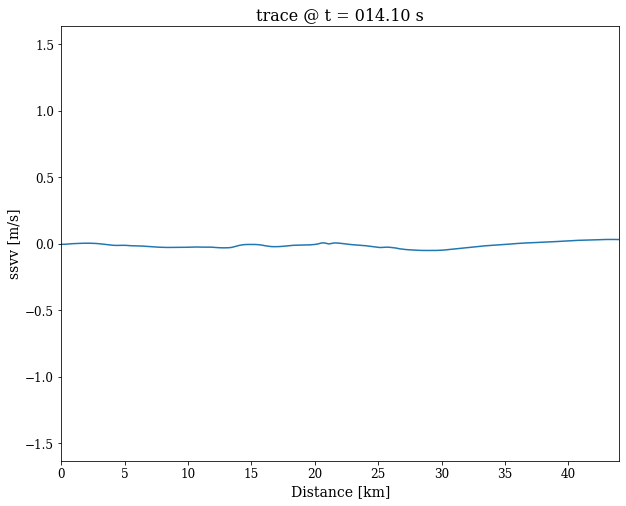

In [16]:
tmp = total_stack.loc[total_stack['Time'] == 14.1]
fig = plt.figure(figsize=(10,8))
plt.plot(distance, tmp.v3)
plt.xlabel("Distance [km]", fontsize=14)
plt.ylabel("ssvv [m/s]", fontsize=14)
plt.xlim(0,max(distance))
plt.ylim(min(total_stack.v3), max(total_stack.v3))
plt.title("trace @ t = {:06.2f} s".format(tmp["Time"].iloc[0]), fontsize=16)

# Loop and movie

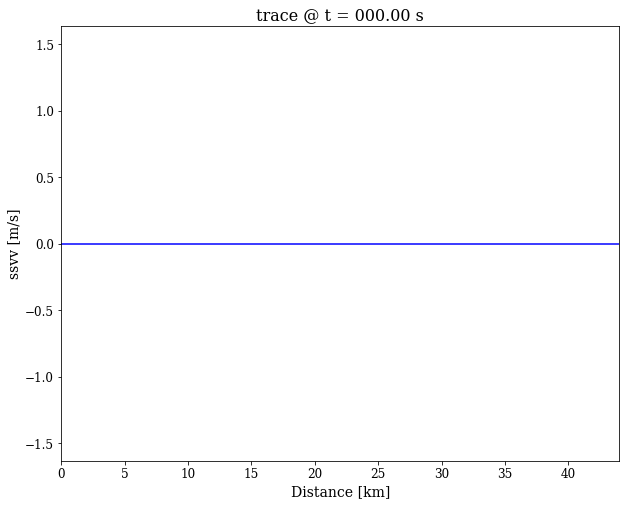

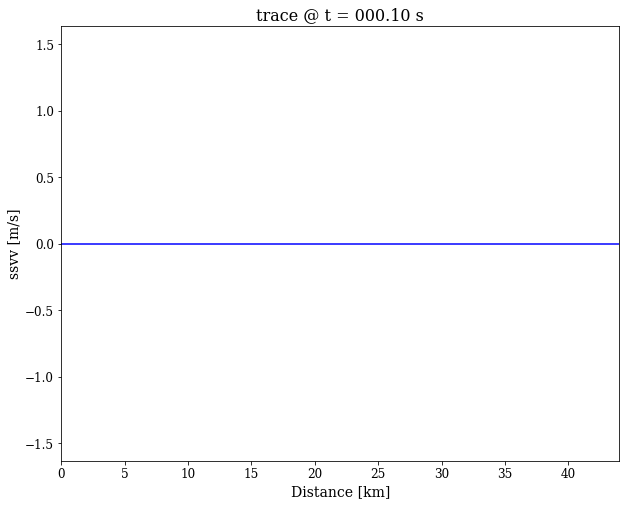

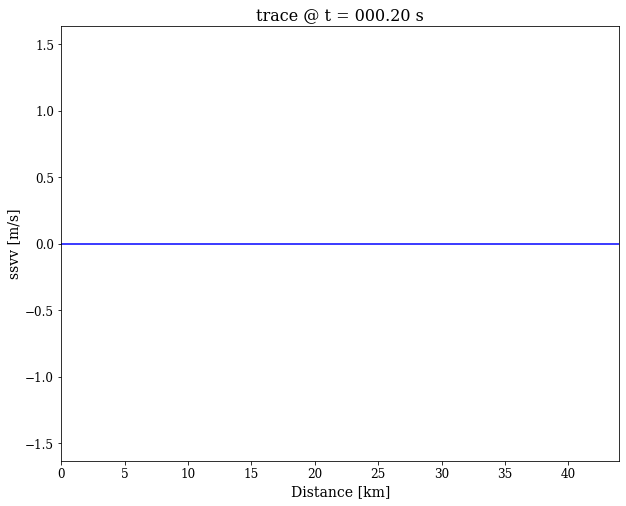

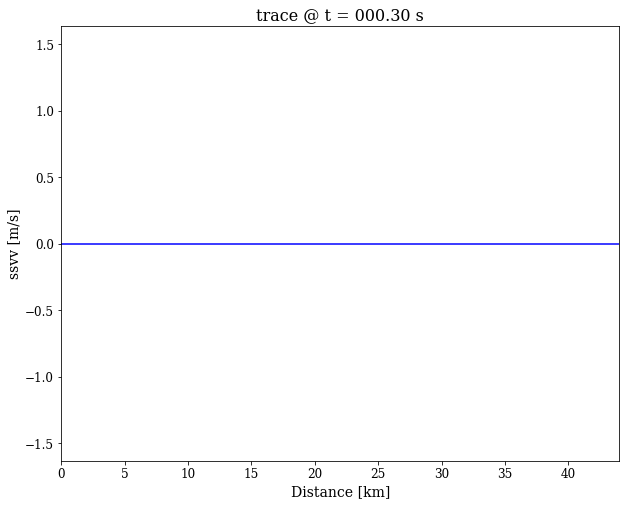

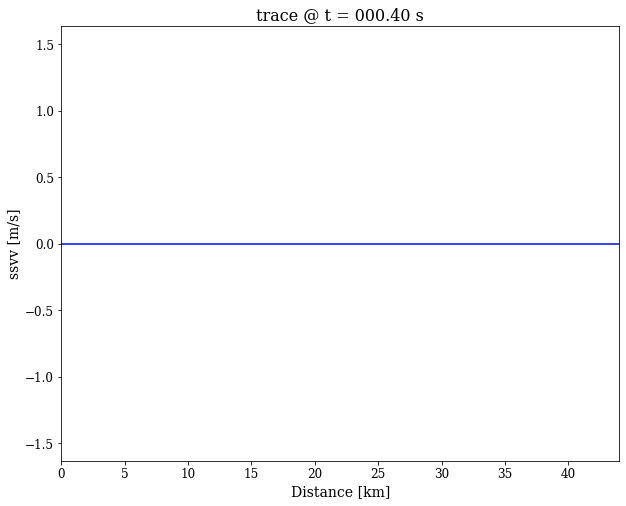

...

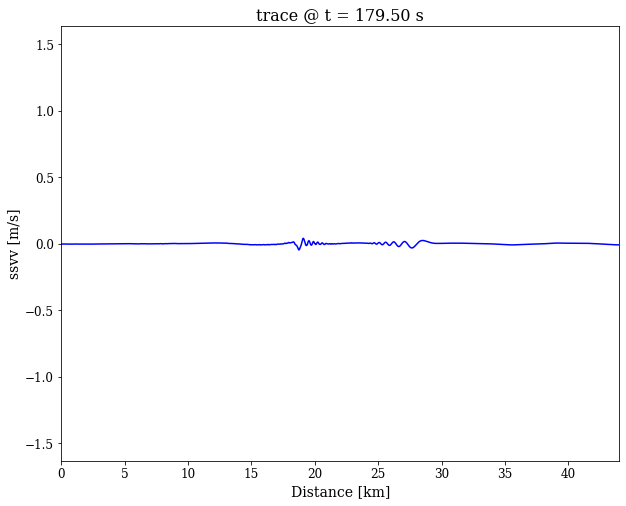

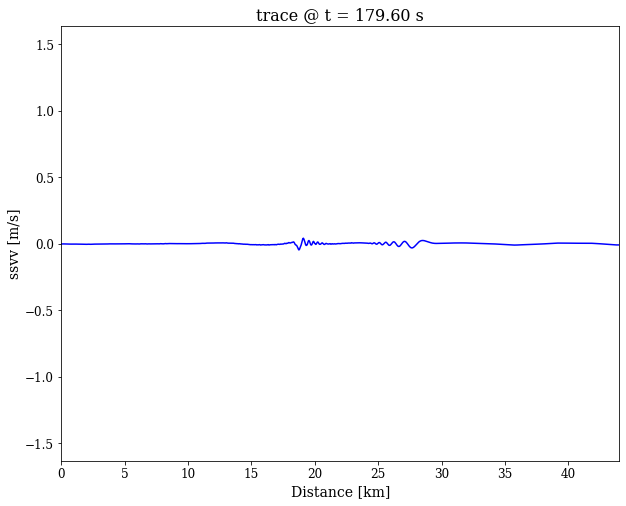

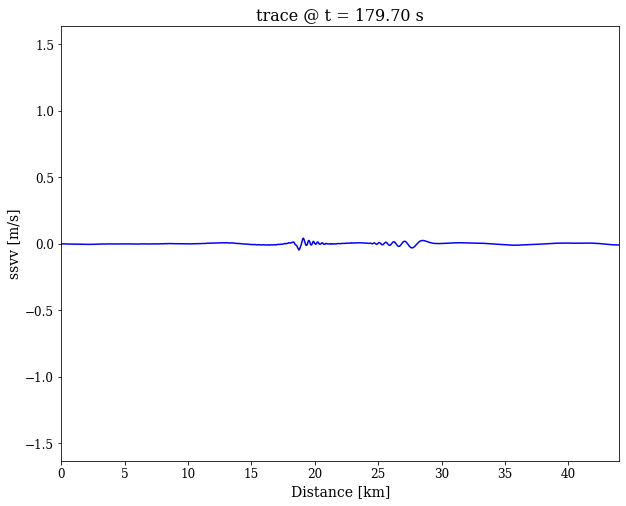

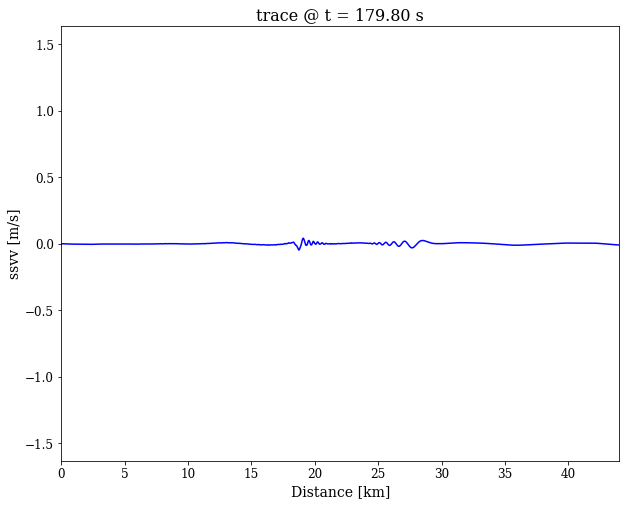

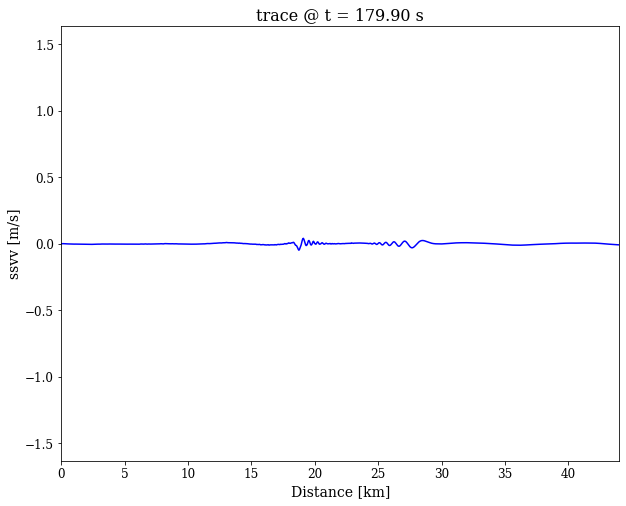

In [17]:
for i in time_array:
    tmp = total_stack.loc[total_stack['Time'] == i]
    fig = plt.figure(figsize=(10,8))
    plt.plot(distance, tmp.v3, color='b')
    plt.xlabel("Distance [km]", fontsize=14)
    plt.ylabel("ssvv [m/s]", fontsize=14)
    plt.xlim(0,max(distance))
    plt.ylim(min(total_stack.v3), max(total_stack.v3))
    plt.title("trace @ t = {:06.2f} s".format(tmp["Time"].iloc[0]), fontsize=16)
    #plt.savefig("./output/trace_{:06.2f}s.png".format(tmp["Time"].iloc[0]))
    plt.savefig("./output/trace_{:03d}.png".format(int(i*10)), dpi=300)
    plt.show()

## Attempts to create gif - better use ffmpeg!

In [ ]:
ndir = "/import/freenas-m-05-seissol/kutschera/HIWI/Scripts/Script4Processing/post_plotting/output2/"
figures = glob.glob(os.path.join(ndir, "trace_*.png"))

In [ ]:
import imageio.v3 as imageio     
images = []
for f in figures:
    images.append(imageio.imread(f))
imageio.imwrite('ssva_v3.gif', images)

In [ ]:
import imageio.v2 as imageio
with imageio.get_writer('ssva_v2.gif', mode='I') as writer:
    for f in figures:
        image = imageio.imread(f)
        writer.append_data(image)